In [1]:
import scanpy as sc
import pandas as pd
from matplotlib import pylab
import random
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import os
import itertools
import plotly.express as px
import yaml


import numpy as np
import random
import anndata as ad
from scipy.sparse import  csr_matrix, issparse
from scipy import sparse

from matplotlib.colors import TwoSlopeNorm

import scanpy.external as sce
import sys

import scvelo as scv

In [2]:
import anndata

In [3]:

sc.settings.set_figure_params(dpi=80, facecolor='white', dpi_save=500)
pylab.rcParams['figure.figsize'] = (6, 6)
homeDir = os.getenv("HOME")
sys.path.insert(1, homeDir+"/utils/")

from PlotPCA_components import *
from AtlasClasses import *
DS="androgen_substudy"
ReferenceTissue="cortex"

with open(homeDir+"/utils/ReferenceDict.yaml", 'r') as file:
    ReferencePaths = yaml.safe_load(file)
    for k in list(ReferencePaths.keys()):
        ReferencePaths[k]["adataPath"] = "/group/testa/Users/davide.castaldi/Polaroids_spinoff"+ReferencePaths[k]["adataPath"]
        #ReferencePaths[k]["signaturePath"] = homeDir+ReferencePaths[k]["signaturePath"]
        ReferencePaths[k]["signaturePath"] = "/group/testa/Users/davide.castaldi/Polaroids_spinoff"+ReferencePaths[k]["signaturePath"]
        ReferencePaths[k]["signaturePurityPath"] = "/group/testa/Users/davide.castaldi/Polaroids_spinoff"+ReferencePaths[k]["signaturePurityPath"]


ReferencePaths


{'cortex': {'dsname': 'Poliudakis2019_cortex',
  'adataPath': '/group/testa/Users/davide.castaldi/Polaroids_spinoff/2_GenerateReferences/cortex.Reference.h5ad',
  'signaturePath': '/group/testa/Users/davide.castaldi/Polaroids_spinoff/2_GenerateReferences/cortex.SignatureGenes.tsv',
  'signaturePurityPath': '/group/testa/Users/davide.castaldi/Polaroids_spinoff/2_GenerateReferences/cortex.SignaturesPurity.tsv',
  'LabelTtransferAggregation': {'oRG': 'Glia',
   'IP': 'IP',
   'ExcitatoryDeepLayer': 'ExcitatoryNeuron',
   'Cycling': 'Cycling',
   'ExcitatoryMigrating': 'ExcitatoryNeuron',
   'Excitatory': 'ExcitatoryNeuron',
   'Endothelium': 'Vascular',
   'vRG': 'Glia',
   'Inhibitory': 'ForebrainInhibitory',
   'OPC': 'OPC',
   'Mic': 'Mic'},
  'RelevantContrasts': {'Inh_vs_Exc': ['cortex_Inhibitory',
    'cortex_Excitatory'],
   'Exc_vs_cycling': ['cortex_Excitatory', 'cortex_CyclingProgenitors']}},
 'cerebellum': {'dsname': 'Aldinger2021_cerebellum',
  'adataPath': '/group/testa/Users

# Import

In [5]:
adata = sc.read_h5ad("./adatas/5.1.{}.PostQC.h5ad".format(DS))


In [6]:
pcs=25
n_neighbs=50

In [9]:
pd.crosstab(adata.obs["condition"], adata.obs["sample_id"])

sample_id,1_CTL01A_393,1_CTL01A_394,1_CTL02A_393,1_CTL02A_394,1_CTL04E_393,1_CTL04E_394,1_CTL08A_393,1_CTL08A_394
condition,,,,,,,,
ANDROGEN_AGONIST,0,5741,0,4101,0,8478,0,6987
DMSO,4777,0,3586,0,6957,0,5199,0


# 1) Intra-condition DEGs Seurat flavour

In [11]:
HVGSCondict = {}
for line in adata.obs["line"].unique().tolist():
    adataGenotype = adata[adata.obs["line"] == line]
    for condition in adataGenotype.obs["condition"].unique().tolist():
        adataCOnd = adataGenotype[adataGenotype.obs["condition"] == condition].copy()

        if condition not in list(HVGSCondict.keys()):
            HVGSCondict[condition] = []

        #Print Nsamples
        nsamples = len(adataCOnd.obs["sample_id"].unique().tolist())
        print(f"Found {nsamples} repliacates for {line} {condition}")
        if nsamples < 3:
            minOverlap = nsamples
        else:
            minOverlap = nsamples-1
        print(f"Only HVGs common to {minOverlap} replicates will be kept")

        sc.pp.highly_variable_genes(adataCOnd, batch_key="sample_id", flavor="seurat", n_top_genes=2000)
        CommonHVGs = set(adataCOnd.var_names[adataCOnd.var["highly_variable_nbatches"] >= minOverlap])
        nHVGs = len(CommonHVGs)
        print(f"Found {nHVGs} common HVGs across {minOverlap} replicates for line {line} exposure {condition} ")
        print("\n")
        HVGSCondict[condition].append(CommonHVGs)

Found 1 repliacates for CTL04E DMSO
Only HVGs common to 1 replicates will be kept
Found 2000 common HVGs across 1 replicates for line CTL04E exposure DMSO 


Found 1 repliacates for CTL04E ANDROGEN_AGONIST
Only HVGs common to 1 replicates will be kept
Found 2000 common HVGs across 1 replicates for line CTL04E exposure ANDROGEN_AGONIST 


Found 1 repliacates for CTL01A DMSO
Only HVGs common to 1 replicates will be kept
Found 2000 common HVGs across 1 replicates for line CTL01A exposure DMSO 


Found 1 repliacates for CTL01A ANDROGEN_AGONIST
Only HVGs common to 1 replicates will be kept
Found 2000 common HVGs across 1 replicates for line CTL01A exposure ANDROGEN_AGONIST 


Found 1 repliacates for CTL08A DMSO
Only HVGs common to 1 replicates will be kept
Found 2000 common HVGs across 1 replicates for line CTL08A exposure DMSO 


Found 1 repliacates for CTL08A ANDROGEN_AGONIST
Only HVGs common to 1 replicates will be kept
Found 2000 common HVGs across 1 replicates for line CTL08A exposure 

# 2) Inter-condition DEGs by line Seurat flavour

In [13]:

sc.pp.highly_variable_genes(adata, batch_key="line", flavor="seurat", n_top_genes=2000)
HVGSLine = set(adata.var_names[adata.var["highly_variable_nbatches"] == len(adata.obs["line"].unique())-2].tolist())
nHVGSLine = len(HVGSLine)
print(f"Found {nHVGSLine} common pan-condition HVGs across both lines ")

# for line in adata.obs["line"].unique().tolist():
#     adataGenotype = adata[adata.obs["line"] == line]
#     sc.pp.highly_variable_genes(adataCOnd, batch_key="sample_id", flavor="seurat", n_top_genes=2000)

#     for condition in adataGenotype.obs["condition"].unique().tolist():
#         adataCOnd = adataGenotype[adataGenotype.obs["condition"] == condition].copy()

#         if condition not in list(HVGSCondict.keys()):
#             HVGSCondict[condition] = []

#         #Print Nsamples
#         nsamples = len(adataCOnd.obs["sample_id"].unique().tolist())
#         print(f"Found {nsamples} repliacates for {line} {condition}")
#         if nsamples < 3:
#             minOverlap = nsamples
#         else:
#             minOverlap = nsamples-1
#         print(f"Only HVGs common to {minOverlap} replicates will be kept")

#         sc.pp.highly_variable_genes(adataCOnd, batch_key="sample_id", flavor="seurat", n_top_genes=2000)
#         CommonHVGs = set(adataCOnd.var_names[adataCOnd.var["highly_variable_nbatches"] >= minOverlap])
#         nHVGs = len(CommonHVGs)
#         print(f"Found {nHVGs} common HVGs across {minOverlap} replicates for line {line} exposure {condition} ")
#         print("\n")
#         HVGSCondict[condition].append(CommonHVGs)

Found 898 common pan-condition HVGs across both lines 


## 3) Combine both HVGs sets

In [14]:

##### First HVGs set
##### First HVGs set

IntersectionDEGs = []
for k in list(HVGSCondict.keys()):
    IntersectionDEGsCond = list(set.intersection(*HVGSCondict[k]))
    nIntersectionDEGsCond = len(IntersectionDEGsCond)
    #print(f"Found {nIntersectionDEGsCond} HVGs from the intersection of both genotypes replicates for exposure {condition} ")
    IntersectionDEGs.extend(IntersectionDEGsCond)

IntersectionDEGs = set(IntersectionDEGs)
nIntersectionDEGsCond = len(IntersectionDEGs)
print(f"Found {nIntersectionDEGsCond} HVGs from the intersection of both genotypes replicates for exposure {condition} ")

##### Second HVGs set
##### Second HVGs set

FinalHVGs = list(IntersectionDEGs.union(HVGSLine))
nFinalHVGs = len(FinalHVGs)
print(f"Found {nFinalHVGs} HVGs from the intersection of both genotypes replicates and across exposures ")


Found 269 HVGs from the intersection of both genotypes replicates for exposure ANDROGEN_AGONIST 
Found 1158 HVGs from the intersection of both genotypes replicates and across exposures 


# Store HVGs and run dimreduct



In [15]:
adata.var["highly_variable_seurat_overlap"] = adata.var_names.isin(FinalHVGs)
print(adata.var["highly_variable_seurat_overlap"].sum())
adata.var["highly_variable"] = adata.var["highly_variable_seurat_overlap"]
adata.layers["logNorm"] = adata.X.copy()
sc.pp.scale(adata)
adata.layers["scaled"] = adata.X.copy()
sc.pp.pca(adata, use_highly_variable=True)


1158


In [16]:

sc.pp.neighbors(adata, n_pcs=pcs, n_neighbors=n_neighbs)
adata.X = adata.layers["logNorm"].copy()


# Harmony

In [17]:
sce.pp.harmony_integrate(adata, key="line")
sc.pp.neighbors(adata, n_pcs=pcs, n_neighbors=n_neighbs, use_rep="X_pca_harmony")
sc.tl.umap(adata)

2025-06-12 06:53:11,238 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-06-12 06:53:18,219 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-06-12 06:53:18,401 - harmonypy - INFO - Iteration 1 of 10
2025-06-12 06:53:30,959 - harmonypy - INFO - Iteration 2 of 10
2025-06-12 06:53:43,146 - harmonypy - INFO - Iteration 3 of 10
2025-06-12 06:53:55,646 - harmonypy - INFO - Iteration 4 of 10
2025-06-12 06:54:03,076 - harmonypy - INFO - Iteration 5 of 10
2025-06-12 06:54:13,617 - harmonypy - INFO - Converged after 5 iterations


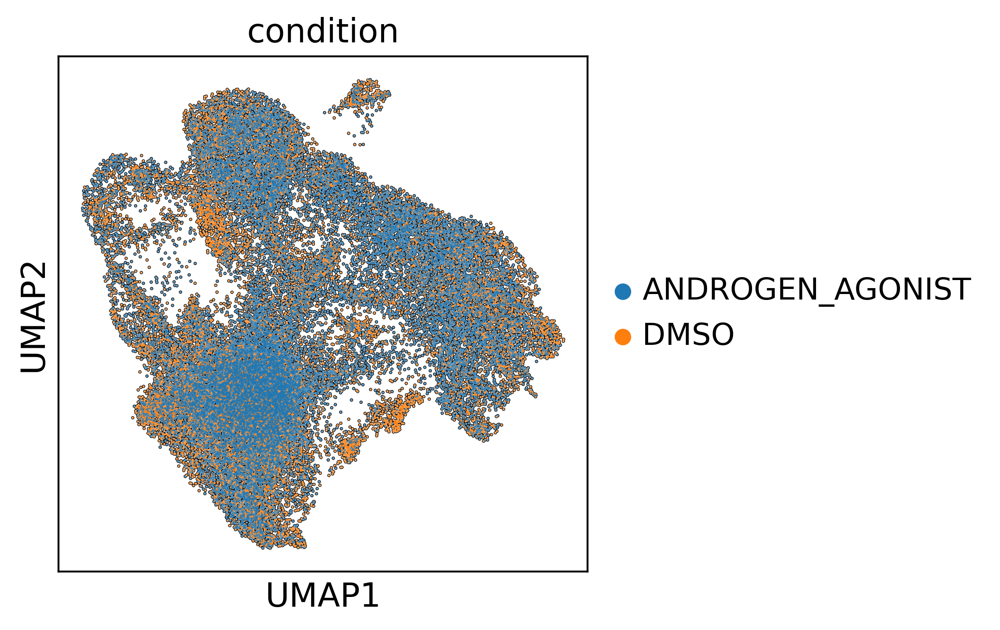

In [18]:
sc.settings.set_figure_params(dpi=200, facecolor='white', dpi_save=500)
pylab.rcParams['figure.figsize'] = (4, 4)
sc.pl.umap(adata, color=["condition"], size=3, vmin='p1', vmax='p99', add_outline=True, outline_width=(.3,0))

In [19]:
# Restore initial params
sc.settings.set_figure_params(dpi=80, facecolor='white', dpi_save=500)
pylab.rcParams['figure.figsize'] = (6, 6)

# Leiden partitioning

In [20]:
sc.tl.leiden(adata, resolution=1, copy=False, random_state=1, key_added="Leiden_1" )

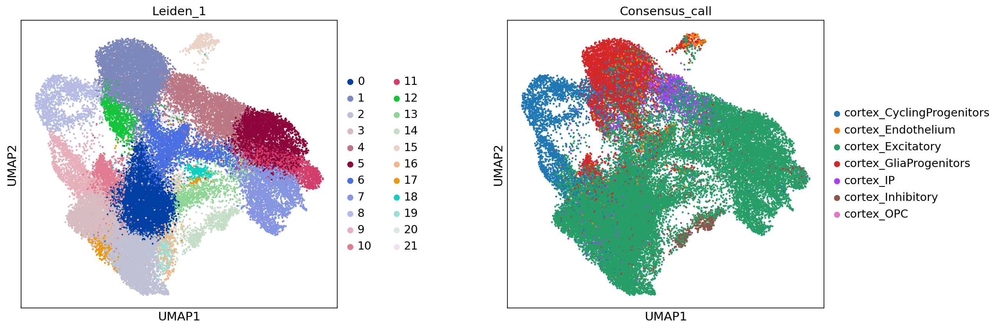

In [28]:
sc.pl.umap(adata, color=[c for c in adata.obs.columns if "Leiden_" in c]+["Consensus_call"], wspace=.4, size=20)

# We plot top markers for leiden

In [22]:
sc.tl.rank_genes_groups(adata, groupby="Leiden_1", use_raw=False)

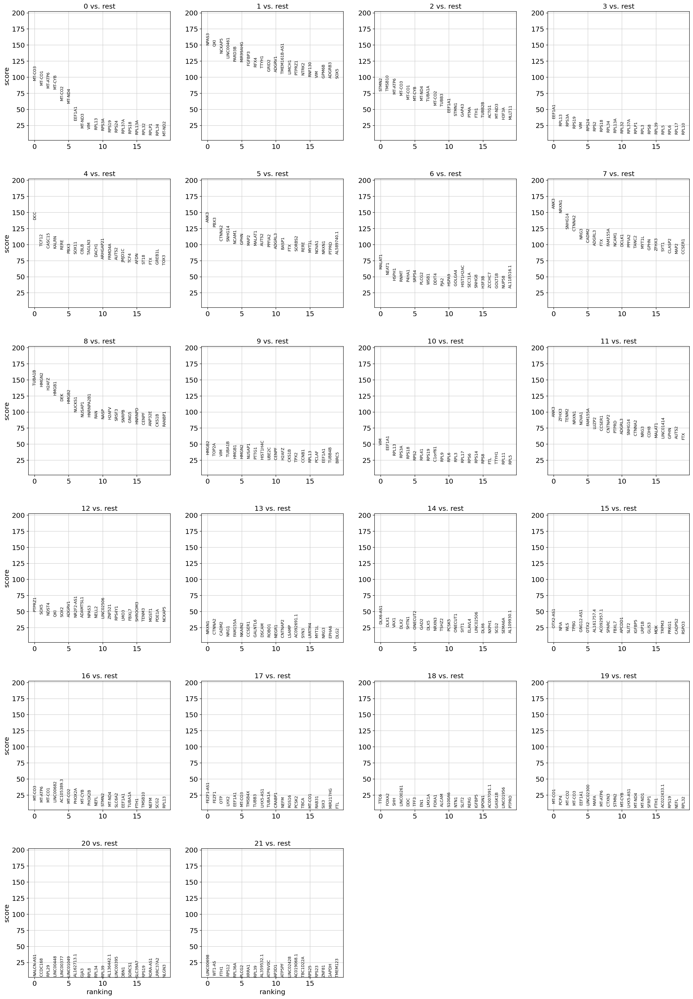

In [23]:
sc.pl.rank_genes_groups(adata)

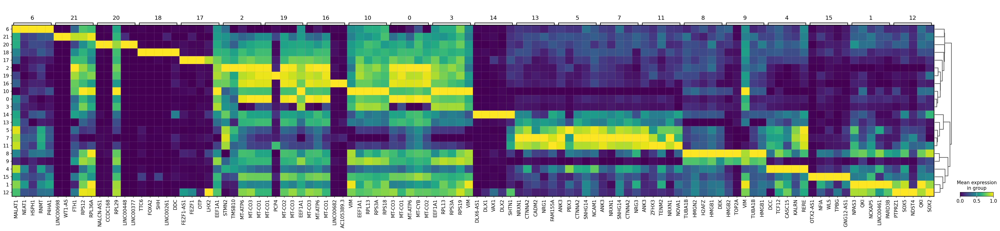

In [29]:
sc.pl.rank_genes_groups_matrixplot(
    adata,
    n_genes=5,standard_scale="var"
)

Markers for Endothelium


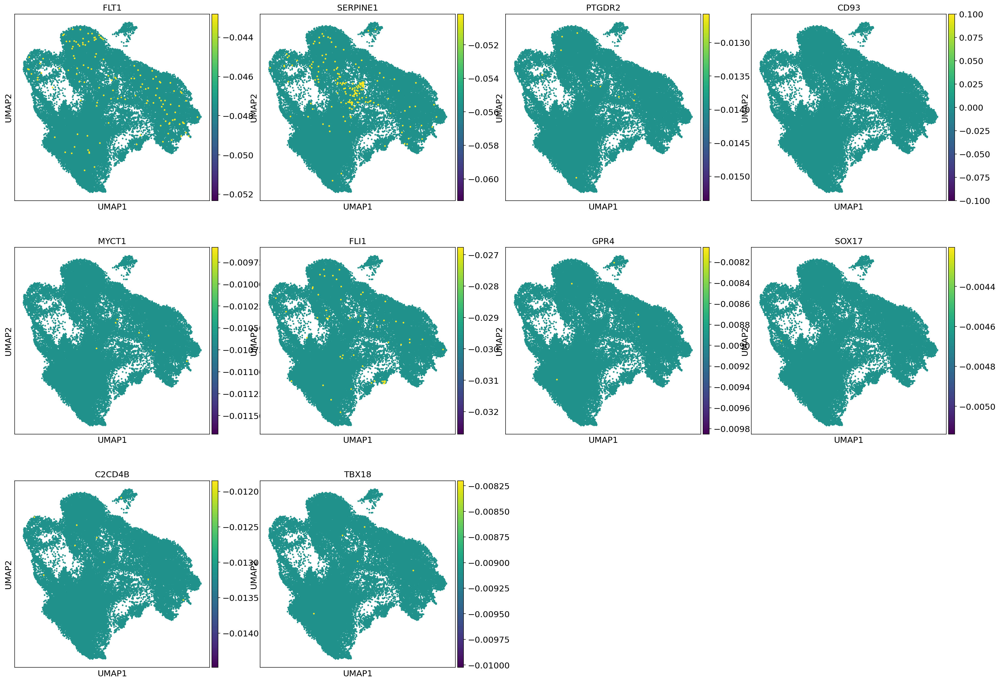

In [25]:
AtlasMarkers = pd.read_excel("/group/testa/Users/davide.castaldi/ENDPOINTS_sc/genes/CelltrypeMarkers.xlsx", index_col=0)

for k in ["Endothelium"]:
    print(f"Markers for {k}")
    MarkerList = AtlasMarkers.loc[AtlasMarkers.Group == k,"Gene"].tolist()
    MarkerList = [i for i in MarkerList if i in adata.var_names]
    MinCells = adata.shape[0] *0.02
    #MarkerList = adata[:,MarkerList].var_names[((adata[:,MarkerList].X > 0).sum(axis = 0) > MinCells).flatten().A1].tolist()
    if len(MarkerList) == 0:
        print(f"Expression of {k} markers detected in less than {MinCells}: skipping")
        continue
    sc.pl.umap(adata, color=MarkerList, size=30,layer="scaled",use_raw=False, vmax='p99')




# First annotation/filter refinement tier


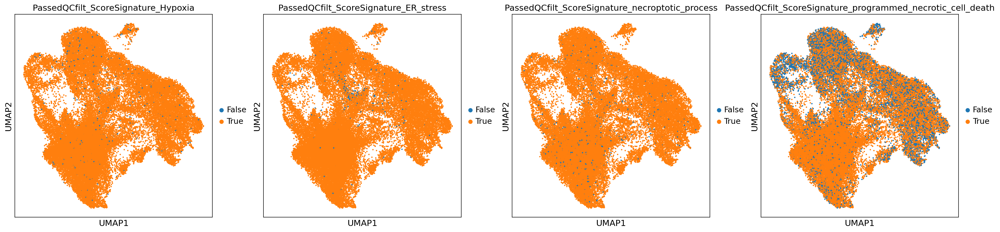

In [26]:
sc.pl.umap(adata, color=[i for i in adata.obs.columns if "PassedQCfilt_ScoreSignature_" in i], size=20)

In [30]:

# We additionally remove all cells cross-labeled as endothelium (mainly leiden_1: 17 & 19 )
adata = adata[adata.obs["Consensus_call"] != "Endothelium"].copy()
adata = adata[~adata.obs["Leiden_1"].isin(["15"])].copy()



In [31]:
HVGSCondict

{'DMSO': [{'CCDC173',
   'AC018413.1',
   'AC131956.3',
   'AC092653.1',
   'CEMP1',
   'KLHL29',
   'SELPLG',
   'PROP1',
   'AC092490.2',
   'SGCG',
   'MT-ND2',
   'CXCL13',
   'PLP1',
   'CCNB2',
   'CCDC80',
   'ANAPC7',
   'GNG8',
   'DHRS2',
   'FBXL7',
   'LINC00681',
   'AC097528.1',
   'AL445213.2',
   'FCAR',
   'OCIAD2',
   'MRPS33',
   'AC084734.1',
   'LINC01205',
   'PTTG1',
   'RBMS3-AS1',
   'PEG10',
   'AL138955.1',
   'SLC39A8',
   'SYNPO2',
   'DDX60',
   'CHRND',
   'PSTPIP2',
   'ZNF319',
   'LINC01221',
   'AP003119.2',
   'BMP4',
   'PTHLH',
   'AC090348.1',
   'AC020907.3',
   'AL732314.6',
   'TSTD1',
   'LRRC7',
   'FOXF2',
   'AL354824.1',
   'LINC02774',
   'AC079414.1',
   'RPS4Y1',
   'HIST1H2BL',
   'AC073578.2',
   'GUCY2C',
   'TAGLN',
   'GTF3C4',
   'HOXB3',
   'CCNB1',
   'LHX9',
   'TECRL',
   'GPR37',
   'NXN',
   'CCDC34',
   'AC104964.2',
   'KIF26B',
   'PLEKHG1',
   'HIST1H2AD',
   'SPAM1',
   'EGFL8',
   'COL4A6',
   'HSPA1A',
   'AP003100.3'

## Re-run HVGs selection dimreduction and integration 

In [32]:
HVGSCondict = {}
for line in adata.obs["line"].unique().tolist():
    adataGenotype = adata[adata.obs["line"] == line]
    for condition in adataGenotype.obs["condition"].unique().tolist():
        adataCOnd = adataGenotype[adataGenotype.obs["condition"] == condition].copy()

        if condition not in list(HVGSCondict.keys()):
            HVGSCondict[condition] = []

        #Print Nsamples
        nsamples = len(adataCOnd.obs["sample_id"].unique().tolist())
        print(f"Found {nsamples} repliacates for {line} {condition}")
        if nsamples < 3:
            minOverlap = nsamples
        else:
            minOverlap = nsamples-1
        print(f"Only HVGs common to {minOverlap} replicates will be kept")

        sc.pp.highly_variable_genes(adataCOnd, batch_key="sample_id", flavor="seurat", n_top_genes=2000)
        CommonHVGs = set(adataCOnd.var_names[adataCOnd.var["highly_variable_nbatches"] >= minOverlap])
        nHVGs = len(CommonHVGs)
        print(f"Found {nHVGs} common HVGs across {minOverlap} replicates for line {line} exposure {condition} ")
        print("\n")
        HVGSCondict[condition].append(CommonHVGs)

Found 1 repliacates for CTL04E DMSO
Only HVGs common to 1 replicates will be kept
Found 2000 common HVGs across 1 replicates for line CTL04E exposure DMSO 


Found 1 repliacates for CTL04E ANDROGEN_AGONIST
Only HVGs common to 1 replicates will be kept
Found 2000 common HVGs across 1 replicates for line CTL04E exposure ANDROGEN_AGONIST 


Found 1 repliacates for CTL01A DMSO
Only HVGs common to 1 replicates will be kept
Found 2000 common HVGs across 1 replicates for line CTL01A exposure DMSO 


Found 1 repliacates for CTL01A ANDROGEN_AGONIST
Only HVGs common to 1 replicates will be kept
Found 2000 common HVGs across 1 replicates for line CTL01A exposure ANDROGEN_AGONIST 


Found 1 repliacates for CTL08A DMSO
Only HVGs common to 1 replicates will be kept
Found 2000 common HVGs across 1 replicates for line CTL08A exposure DMSO 


Found 1 repliacates for CTL08A ANDROGEN_AGONIST
Only HVGs common to 1 replicates will be kept
Found 2000 common HVGs across 1 replicates for line CTL08A exposure 

# 2) Inter-condition DEGs by line Seurat flavour

In [33]:

sc.pp.highly_variable_genes(adata, batch_key="line", flavor="seurat", n_top_genes=2000)
HVGSLine = set(adata.var_names[adata.var["highly_variable_nbatches"] == 2].tolist())
nHVGSLine = len(HVGSLine)
print(f"Found {nHVGSLine} common pan-condition HVGs across both lines ")



Found 886 common pan-condition HVGs across both lines 


## 3) Combine both HVGs sets

In [34]:

##### First HVGs set
##### First HVGs set

IntersectionDEGs = []
for k in list(HVGSCondict.keys()):
    IntersectionDEGsCond = list(set.intersection(*HVGSCondict[k]))
    nIntersectionDEGsCond = len(IntersectionDEGsCond)
    #print(f"Found {nIntersectionDEGsCond} HVGs from the intersection of both genotypes replicates for exposure {condition} ")
    IntersectionDEGs.extend(IntersectionDEGsCond)

IntersectionDEGs = set(IntersectionDEGs)
nIntersectionDEGsCond = len(IntersectionDEGs)
print(f"Found {nIntersectionDEGsCond} HVGs from the intersection of both genotypes replicates for exposure {condition} ")

##### Second HVGs set
##### Second HVGs set

FinalHVGs = list(IntersectionDEGs.union(HVGSLine))
nFinalHVGs = len(FinalHVGs)
print(f"Found {nFinalHVGs} HVGs from the intersection of both genotypes replicates and across exposures ")


Found 262 HVGs from the intersection of both genotypes replicates for exposure ANDROGEN_AGONIST 
Found 1138 HVGs from the intersection of both genotypes replicates and across exposures 


# Store HVGs and run dimreduct



In [35]:
adata.var["highly_variable_seurat_overlap"] = adata.var_names.isin(FinalHVGs)
print(adata.var["highly_variable_seurat_overlap"].sum())
adata.var["highly_variable"] = adata.var["highly_variable_seurat_overlap"]
sc.pp.scale(adata)
adata.layers["scaled"] = adata.X.copy()
sc.pp.pca(adata, use_highly_variable=True)
sc.pp.neighbors(adata, n_pcs=pcs, n_neighbors=n_neighbs)
adata.X = adata.layers["logNorm"].copy()


1138


# Harmony

In [36]:
sce.pp.harmony_integrate(adata, key="line")
sc.pp.neighbors(adata, n_pcs=pcs, n_neighbors=n_neighbs, use_rep="X_pca_harmony")
sc.tl.umap(adata)


2025-06-12 07:51:57,545 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-06-12 07:52:03,409 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-06-12 07:52:03,566 - harmonypy - INFO - Iteration 1 of 10
2025-06-12 07:52:15,706 - harmonypy - INFO - Iteration 2 of 10
2025-06-12 07:52:27,508 - harmonypy - INFO - Iteration 3 of 10
2025-06-12 07:52:38,795 - harmonypy - INFO - Iteration 4 of 10
2025-06-12 07:52:43,596 - harmonypy - INFO - Iteration 5 of 10
2025-06-12 07:52:48,953 - harmonypy - INFO - Converged after 5 iterations


Markers for Cycling


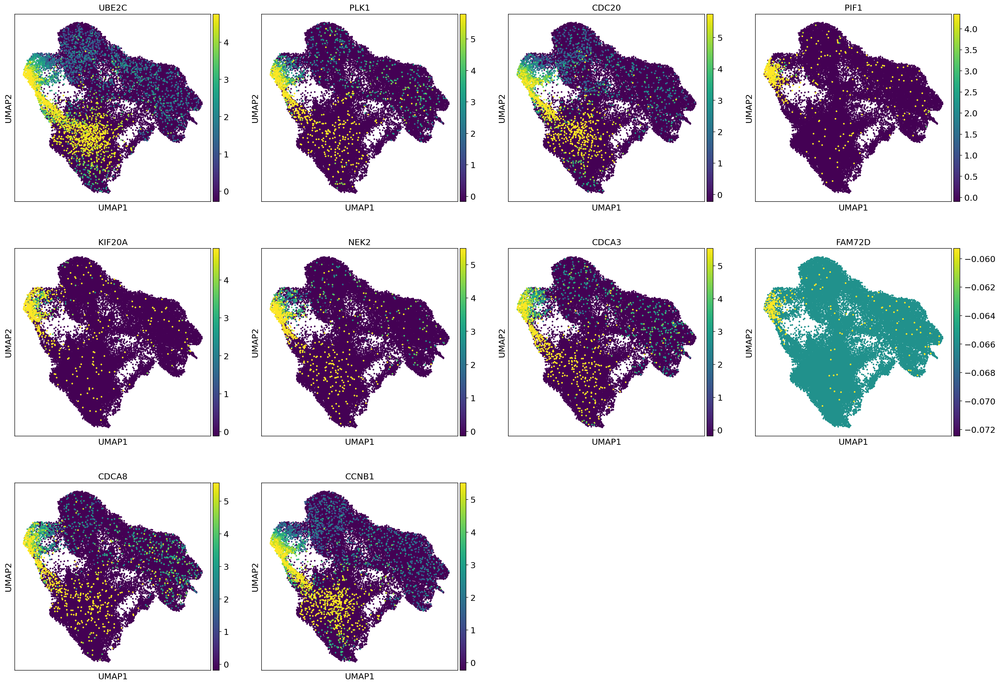

Markers for Endothelium


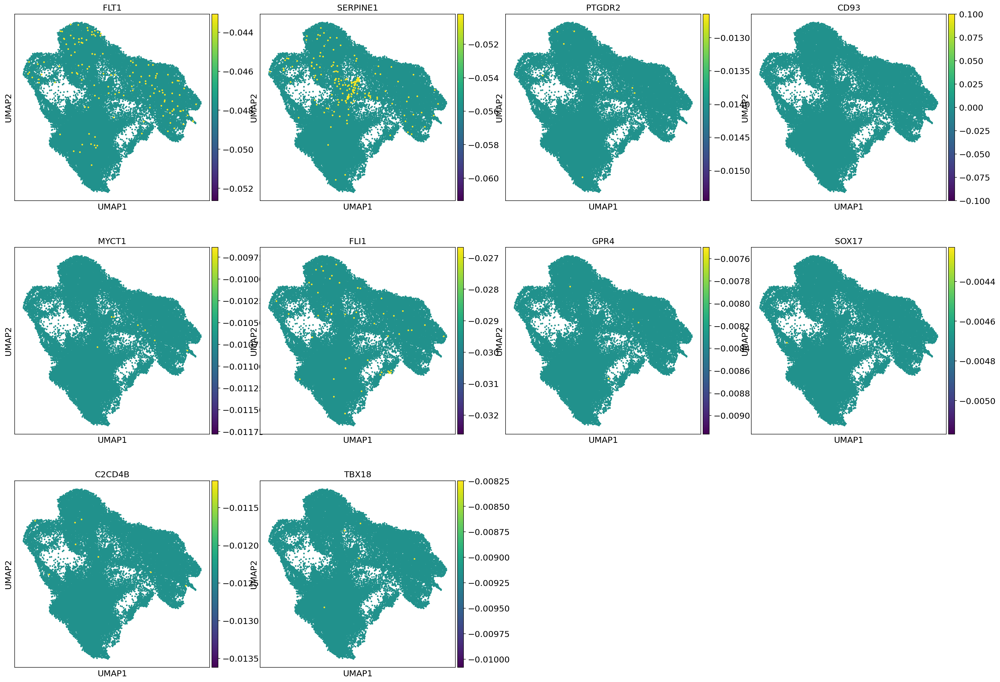

Markers for Excitatory


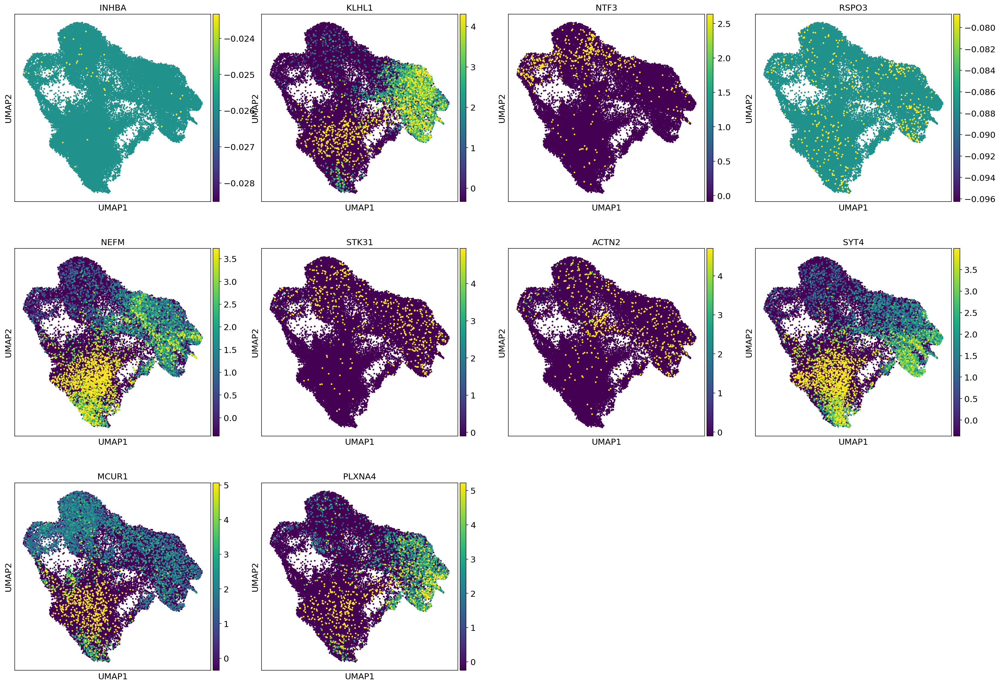

Markers for ExcitatoryDeepLayer


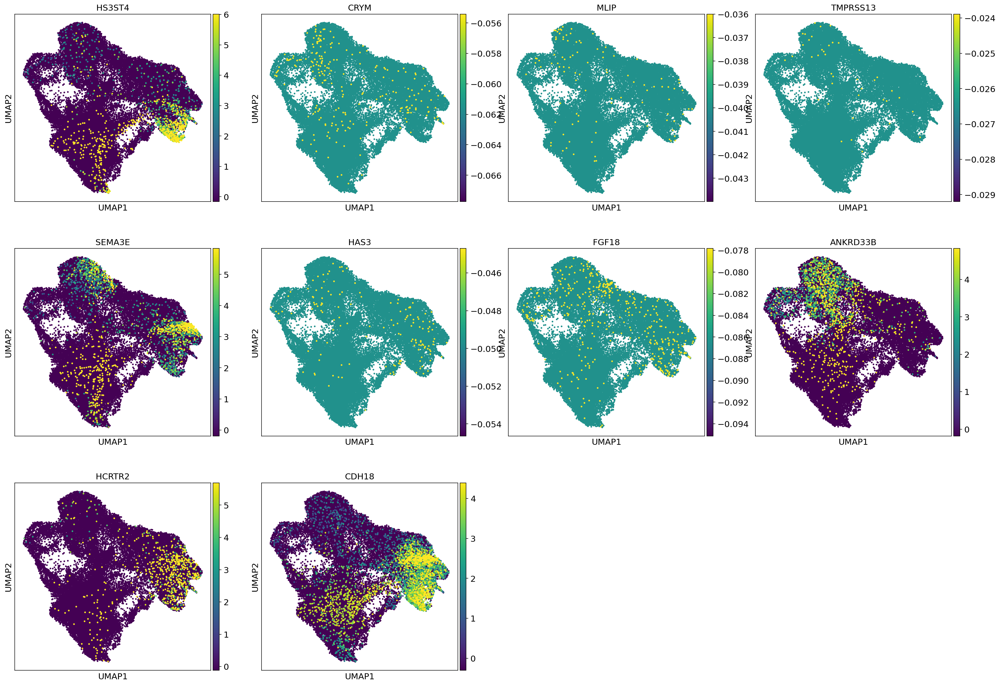

Markers for ExcitatoryMigrating


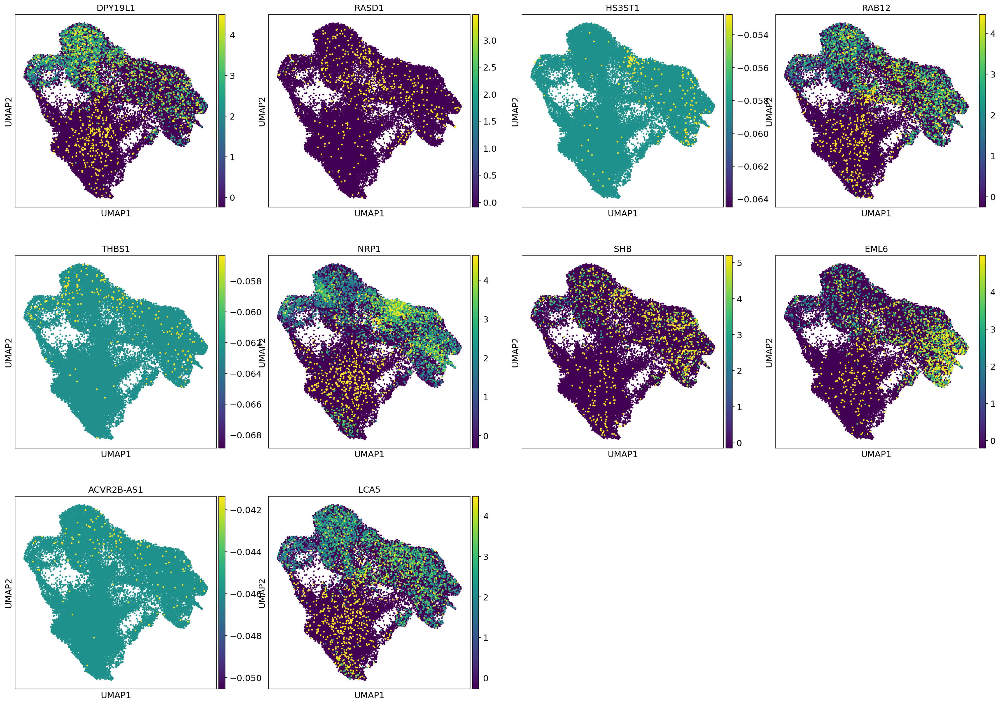

Markers for IP


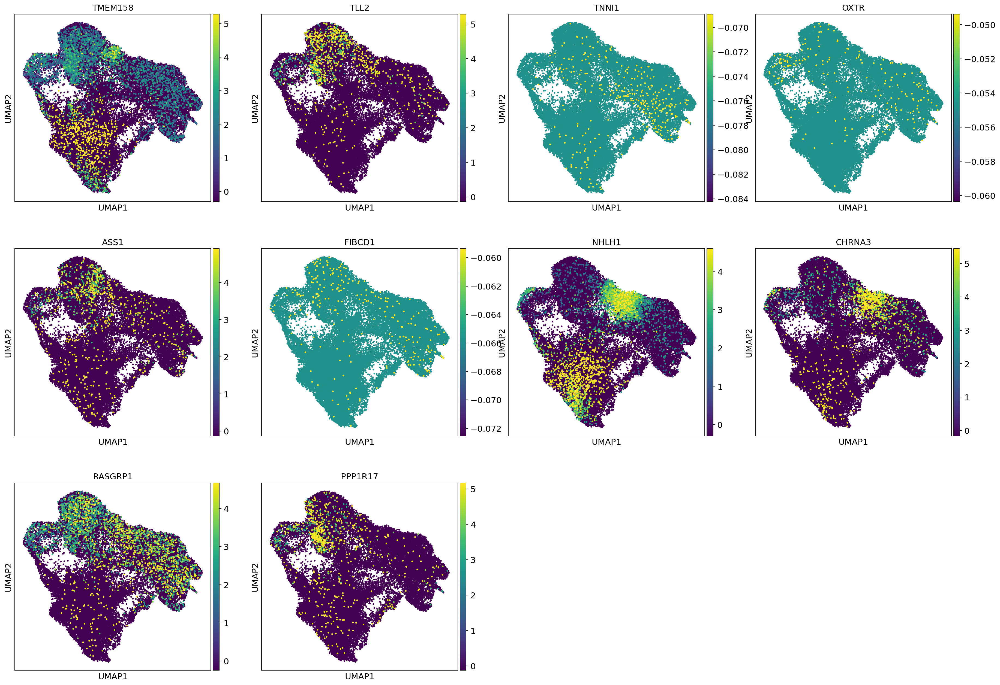

Markers for Inhibitory


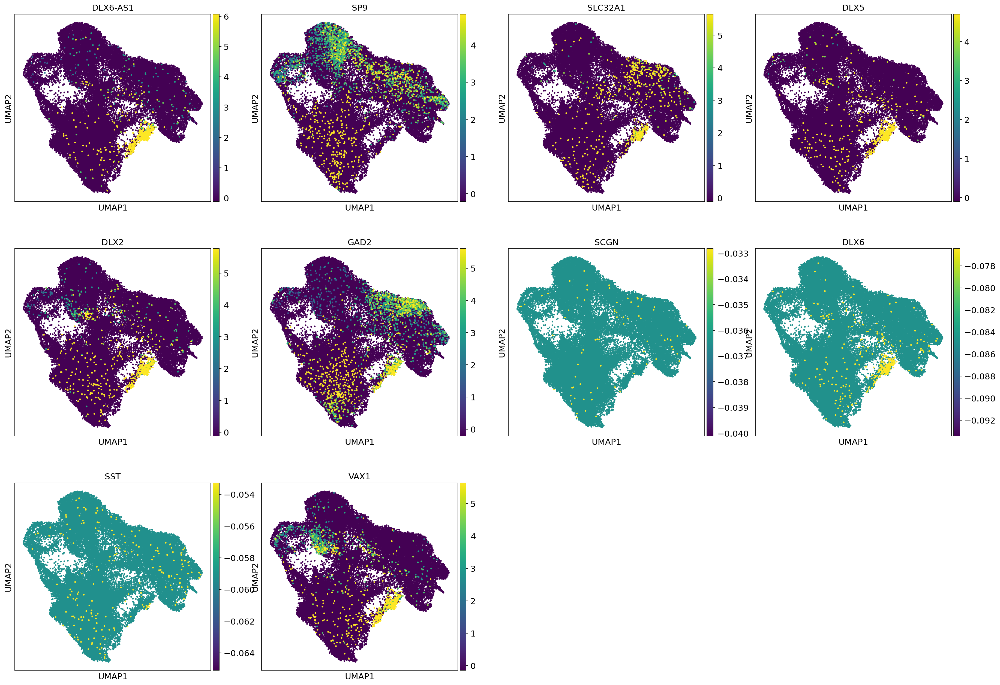

Markers for Mic


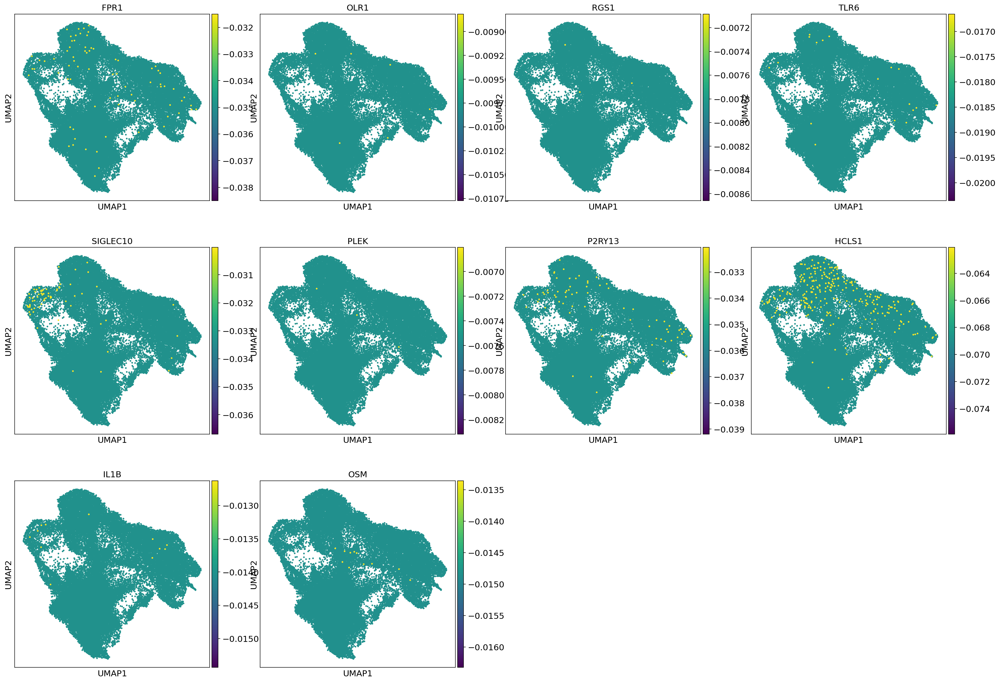

Markers for OPC


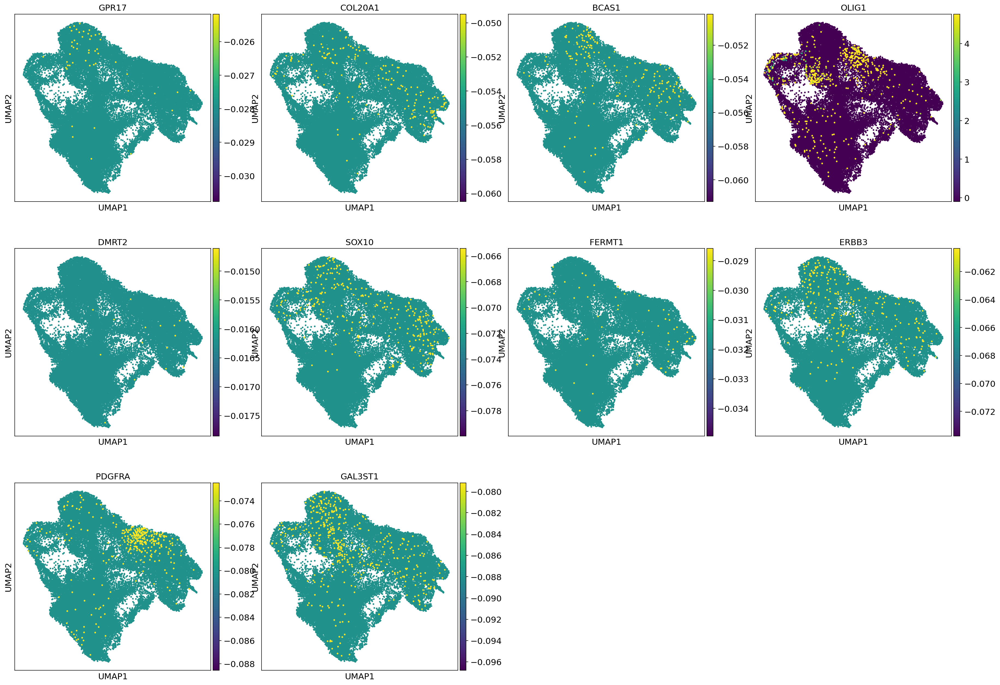

Markers for oRG


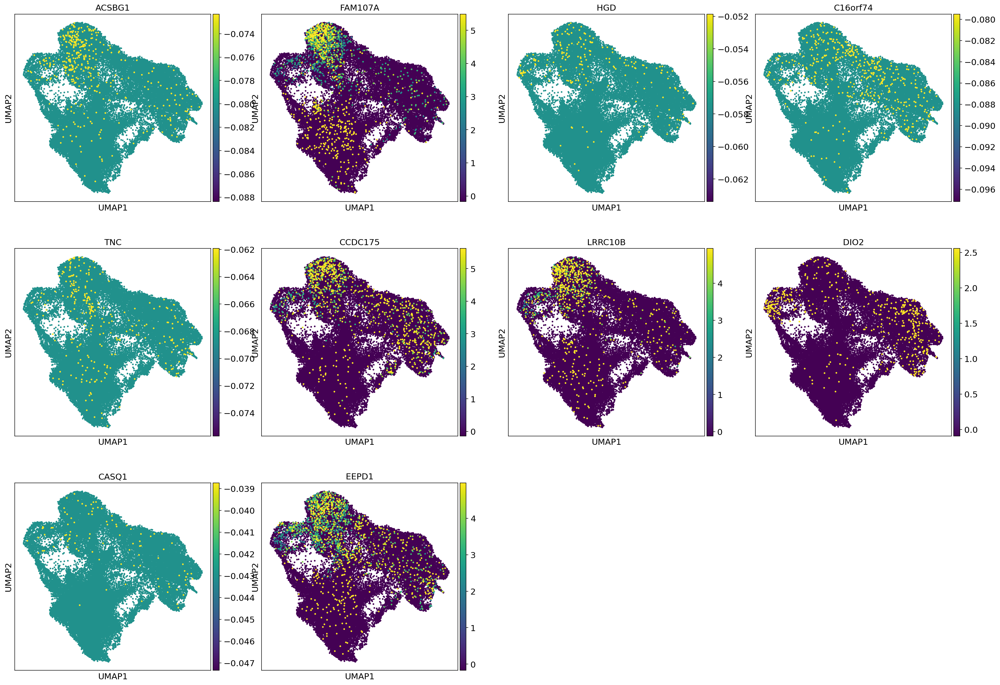

Markers for vRG


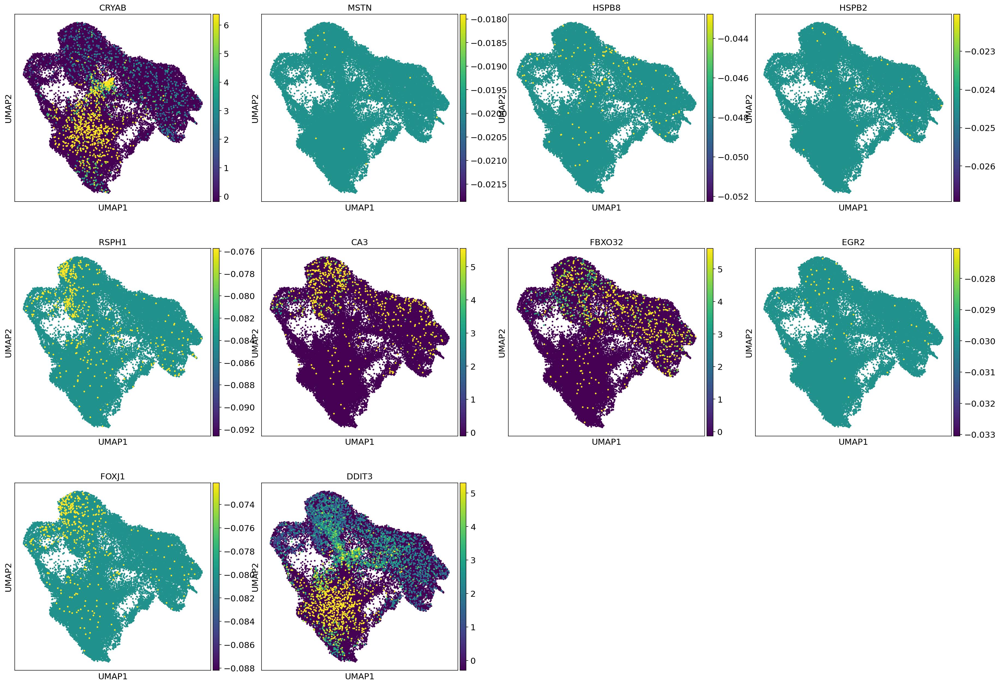

In [37]:
AtlasMarkers = pd.read_excel("/group/testa/Users/davide.castaldi/ENDPOINTS_sc/genes/CelltrypeMarkers.xlsx", index_col=0)

for k in AtlasMarkers.Group.unique():
    print(f"Markers for {k}")
    MarkerList = AtlasMarkers.loc[AtlasMarkers.Group == k,"Gene"].tolist()
    MarkerList = [i for i in MarkerList if i in adata.var_names]
    MinCells = adata.shape[0] *0.02
    #MarkerList = adata[:,MarkerList].var_names[((adata[:,MarkerList].X > 0).sum(axis = 0) > MinCells).flatten().A1].tolist()
    if len(MarkerList) == 0:
        print(f"Expression of {k} markers detected in less than {MinCells}: skipping")
        continue
    sc.pl.umap(adata, color=MarkerList, size=30,layer="scaled",use_raw=False, vmax='p99')
    #sc.pl.draw_graph(adata, color=MarkerList, size=30,layer="scaled",use_raw=False, vmax='p99')



In [38]:
sc.tl.leiden(adata, resolution=1, copy=False, random_state=1, key_added="Leiden_1" )

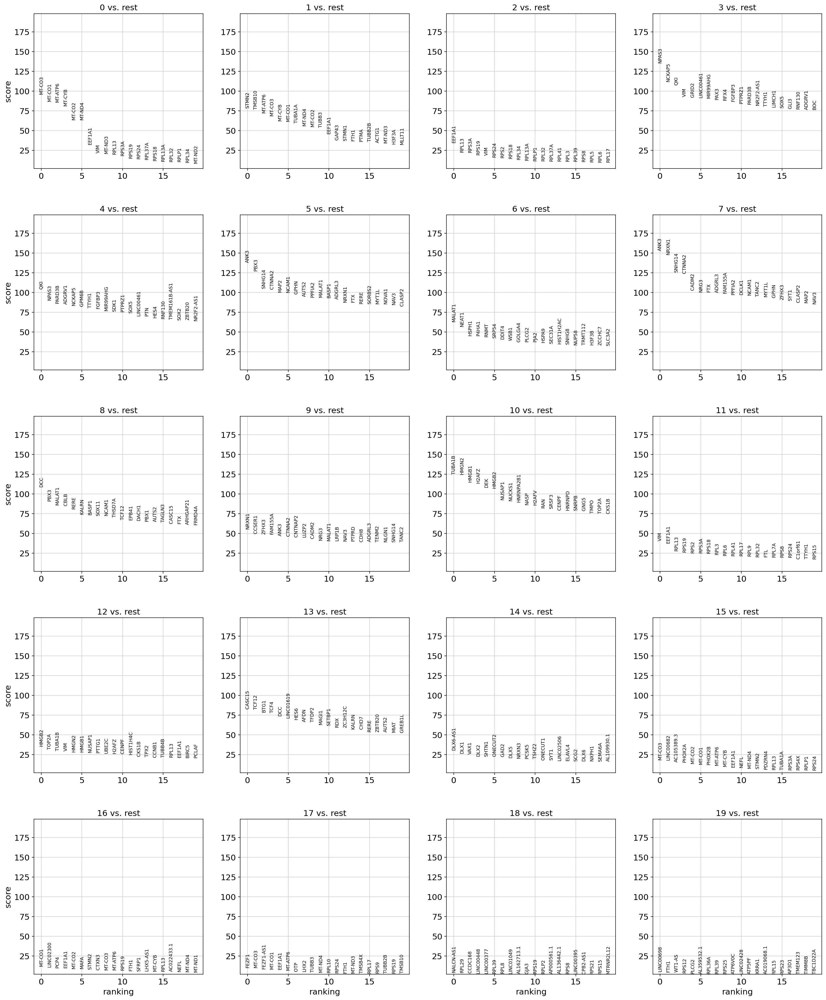

In [39]:
sc.tl.rank_genes_groups(adata, groupby="Leiden_1", use_raw=False)
sc.pl.rank_genes_groups(adata)

# Final markers plot and annotation

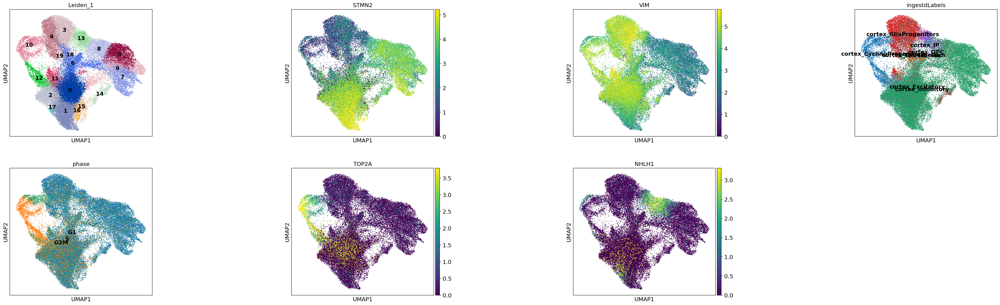

In [40]:
sc.pl.umap(adata, color=["Leiden_1","STMN2","VIM","ingestdLabels","phase","TOP2A","NHLH1"],  size=10, wspace=.8, legend_loc="on data",  vmax="p99")

# Save

In [41]:
adata.write_h5ad("./adatas/6.1.Annotated.{}.h5ad".format(DS))


# Save for cellXgene

In [42]:
# Save for cellxgene
tmp = adata.copy()
import scipy.sparse as sp

tmp.X = tmp.layers["logNorm"].copy()
if not sp.issparse(tmp.X):
    tmp.X = sp.csr_matrix(tmp.X)
    

del tmp.uns
del tmp.varm
del tmp.obsp
del tmp.layers
tmp.obs.columns[tmp.obs.isna().any()].tolist()
tmp.obs = tmp.obs.astype(str)

tmp.write_h5ad("/group/testa/Common/scRNAseq/visualization/ENDPOINTS_sc/{}.h5ad".format(DS))